# Computer Vision - P3

·**Image segmentation**: Using Felzenswhalbs, Slic and Quickshift. 

· **Felzenswhalbs** --> Clustering segmentation. Calculated for different values.

· **Slic** --> K-Means segmentation

· **Comparison of segmentation algorithms** --> Compares with: Original image, Salt and pepper noise version of this image, Flipped image (horizontally), Canny edge detector result of this image.

· **Segmentation using clustering** --> hierarchical clustering (AgglomerativeClustering)

· **Video Segmentation** --> differenciate videos using histogram. Background substraction 

## Delivery

Your overall grading will be penalized if the following requirements are not fulfilled:

- Implemented code should be commented exhaustively and in **English**. 

- The questions introduced in the exercises must be answered.

- Add title to the figures to explain what is displayed.

- Answers to questions also need to be in **English**.

- Make sure to print and plot exactly what it is indicated. If a reference image is provided, your output is expected to be exactly the same unless instructed differently. 

- The deliverable of both parts must be a file named **P3_Student1_Student2.zip** that includes:
    - The notebook P3_Student1_Student2.ipynb completed with the solutions to the exercises and their corresponding comments.
    - All the images used in this notebook (upload the ones that were not provided)
    
- It is required that your code can be run by us without need of any modification and without getting any errors.

- Use packages and solutions that were covered in your class and tutorials. If you are unsure about using a particular package, you should seek clarification from your instructor to confirm whether it is allowed.

- Please refrain from utilizing resources like ChatGPT to complete this lab assignment.

**Deadline (Campus Virtual): Group A & F: November 14th, 23:00 h; Group B: November 14th, 23:00 h** 

==============================================================================================
## Practicum 3: Image and Video Segmentation

==============================================================================================

The main topics of Laboratory 3 are:

3.1. Segmentation of video shots with static scenes.

3.2. Background subtraction.

3.3. Segmentation of images.

The following chapters of the book “Computer Vision: Algorithms and Applicatons” from Richard Szeliski have further information about the topic:

* Chapter 4: Computer Vision: Algorithms and Applications.

* Chapter 5: Segmentation.



In [2]:
# Example
import numpy as np
import skimage
from skimage import io
import matplotlib.pyplot as plt
import matplotlib.animation as animation

## 3.1 Segmentation of images

Apply the image segmentation methods (Felzenswhalbs, Slic and Quickshift) based on the clustering of points corresponding to the pixels but in the feature space RGB-XY space.


**Hint**: 
- Different image segmentation commands can be found in skimage.segmentation.
- Use the function segmentation.mark_boundaries for seeing the boundaries of the segments.
- Use the inline pluggin to visualize images (%matplotlib inline).

<img src="images_notebook/image_Segmentation.png" width=600>

### Felzenszwalb's efficient graph based segmentation
Felzenszwalb's efficient graph based segmentation
This fast 2D image segmentation algorithm, proposed in [1] is popular in the computer vision community. Check your theory slides to remind what it is about.
The algorithm has a single scale parameter related to the tau parameter that influences the segment size. Remind what the tau parameter is doing in the algorithm! The parameter scale sets an observation level. Higher scale means less and larger segments.
sigma is the diameter of a Gaussian kernel, used for smoothing the image prior to segmentation.
The number of produced segments as well as their size can only be controlled indirectly through scale and themin_size parameter. Segment size within an image can vary greatly depending on local contrast. The actual size and number of segments can vary greatly, depending on local contrast.
For RGB images, the algorithm uses the euclidean distance between pixels in color space.


a) Read 'barcelona.jpeg' image from the folder 'images' and segment it using the Felzenszwalbs's method. Comment the result.

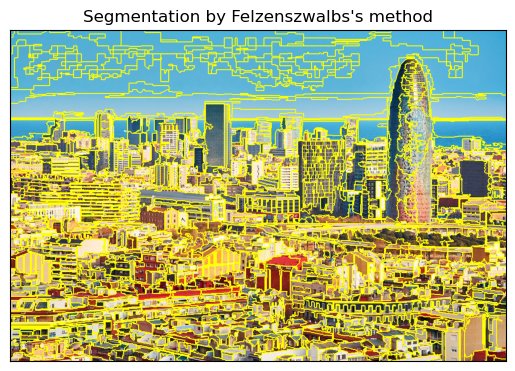

In [4]:
from skimage import io
from skimage.util import img_as_float
from skimage.color import rgb2gray
from skimage.filters import sobel
from skimage.segmentation import felzenszwalb, slic, quickshift
from skimage.segmentation import mark_boundaries

img = io.imread('images_notebook/barcelona.jpeg')

segments_fz = felzenszwalb(img,  scale=200, sigma=0.5, min_size=100)

plt.imshow(mark_boundaries(img, segments_fz)) 
plt.title("Segmentation by Felzenszwalbs's method")
plt.xticks([])
plt.yticks([])
plt.show()

b) Create a function where you explore at least 3 different parameter combinations in order to obtain a better image segmentation. Your function should receive the image and the set of parameters you would like to change. It should also resize your image to be a third part of the original image size. Your function results should be a visualization of the results and a print of the number of segments.  


Answer the following questions:
- Is it critical to convert the image in grayscale in order to do the image segmentation? **No, note that we use a RGB image. So it is not necessary**
- Is it critical to convert the image in float in order to do the image segmentation? **No, the image dtype is uint8 and we have not converted it to float in a) to segmentate. Moreover, after rescaling, img_small is a float image and we can still use Felzenszwalb. This implies there is no issue related to the image dtype.**
- Which are the optimal values according to your subjective perception? **In this experiment we think scale=200, sigma=0.5 and min_size=100 because in our opinion it separates all the relevant objects in different segments and it is more comprehensible compared to the other images.**
- How does each parameter behave? **The 3 main parameters we have varied are scale, sigma and min_size. The first one sets an observation level (higher scale means less and larger segments), the second one is used for the Gaussian kernel applied to smooth the image before the segmentation and, finally, min_size defines the minimum component size (to avoid getting small segments), minimum number of pixels to be a segment itself, if less, it unifies with neighbours.**
- Does the image reduction affect the optimal values? **Absolutely, note that previously we have taken scale=200, sigma=0.5, min_size=50 but the segmentation with the image reduction is much cleaner than the previous one (2307 segments VS 267 segments).**

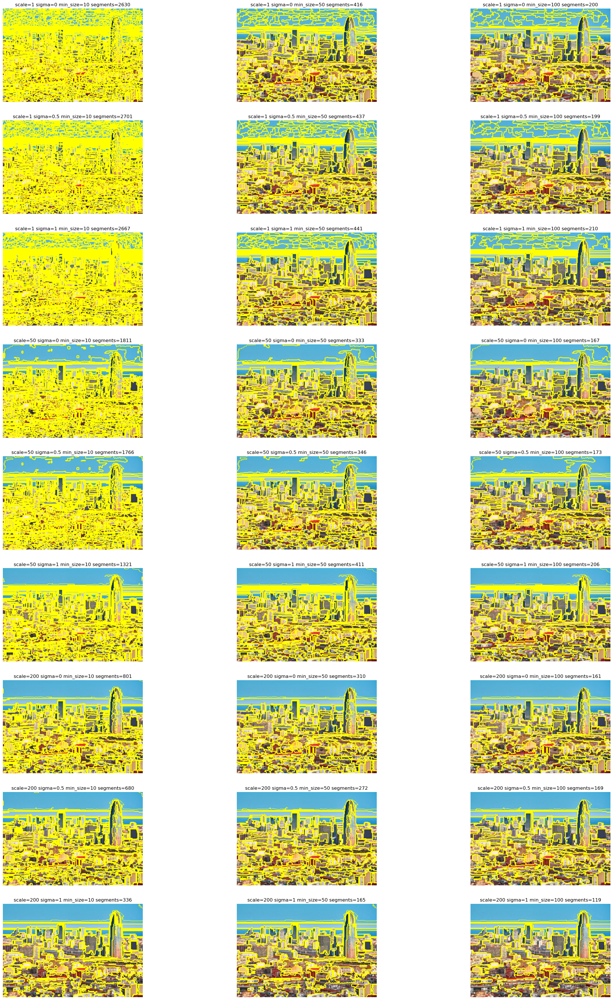

In [9]:
from skimage.transform import resize, rescale  # To reshape the image to the desired pixels
def felzenszwalb_params(img, scales, sigmas, min_sizes):
    img = img_as_float(img)
    img = resize(img, (img.shape[0]//3, img.shape[1]//3, 3))
    
    # Alternative Rescaled image
    #img_small = rescale(img, 1/3, multichannel=True)
    
    fig, ax = plt.subplots(9, 3, figsize=(30, 45), sharex=True, sharey=True)
    for i in range(len(scales)):
        for j in range(len(sigmas)):
            for k in range(len(min_sizes)):
                segments = felzenszwalb(img, scale=scales[i], sigma=sigmas[j], min_size=min_sizes[k])
                ax[i*3 + j, k].imshow(mark_boundaries(img, segments))
                ax[i*3 + j, k].set_title(f"scale={scales[i]} sigma={sigmas[j]} min_size={min_sizes[k]} segments={len(np.unique(segments))}")
                ax[i*3 + j, k].axis('off')
                
    plt.show()

    


img = io.imread('images_notebook/barcelona.jpeg')
scales = [1, 50, 200]
sigmas = [0, 0.5, 1]
min_sizes = [10,50,100]
felzenszwalb_params(img, scales, sigmas, min_sizes)

c) Comment the definition of the algorithm (use approximately 3 lines at most), its advantages and disadvantages.
**Answer: The algorithm segmentates an image by creating fast, minimum spanning trees based on clustering the image grid. Nodes are added to a cluster if the distance between them is lower than the one between 2 nodes inside it.
The distance between pixels is determined by the euclidian in the 5-dimensional space (their coordinates are their position and their RGB values). It allows us to capture the global features of an image and non spatially connected regions (like the sea in the previous experiment). However, it can only detect high changes in intensity (note that the high building on the right is poorly segmented).**

### SLIC - K-Means based image segmentation
d) Segment the same image using the SLIC image segmentation algorithm using the parameters by default. 

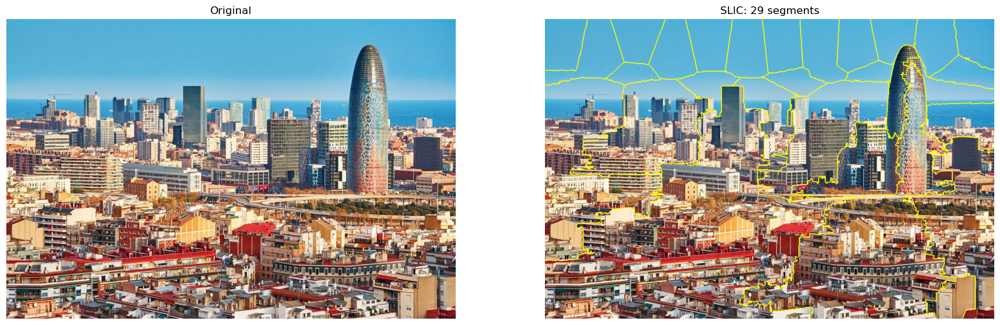

In [10]:
from skimage.segmentation import slic

# Read image and segment it using SLIC
bcn = io.imread("images_notebook/barcelona.jpeg")
segments = slic(bcn, start_label=1)
bcn_slic = mark_boundaries(bcn, segments)

fig=plt.figure(figsize=(20,15))

# First image: Original
fig.add_subplot(1,2,1)
plt.title("Original")
plt.imshow(bcn) 
plt.axis("off")

# Second image: SLIC
fig.add_subplot(1,2,2)
plt.title(f"SLIC: {len(np.unique(segments))} segments")
plt.imshow(bcn_slic) 
plt.axis("off")

plt.show()

Create a function where you explore at least 3 different parameter combinations in order to obtain a better image segmentation. Your function should receive the image and the set of parameters you would like to change. It should also resize your image to be a third part of the original image size. Your function results should be a visualization of the results and a print of the number of segments.  


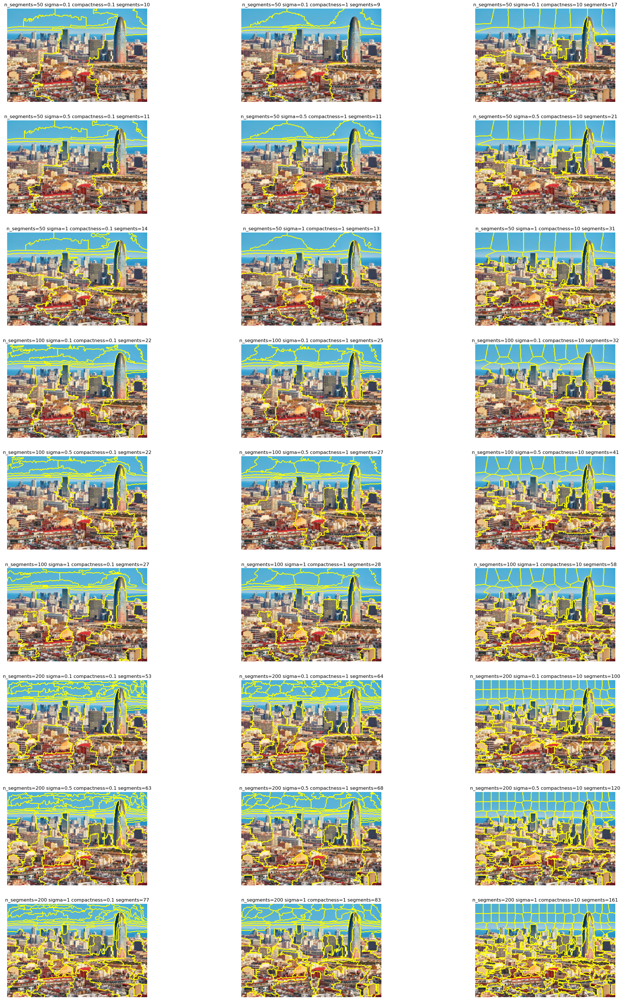

In [11]:
def slic_params(img, n_segments, compactness, sigmas):
    img = img_as_float(img)
    img = resize(img, (img.shape[0]//3, img.shape[1]//3, 3))
    
    # Alternative Rescaled image
    #img_small = rescale(img, 1/3, multichannel=True)
    
    fig, ax = plt.subplots(9, 3, figsize=(30, 45), sharex=True, sharey=True)
    for i in range(len(n_segments)):
        for j in range(len(sigmas)):
            for k in range(len(compactness)):
                segments = slic(img, n_segments=n_segments[i], sigma=sigmas[j], compactness=compactness[k])
                ax[i*3 + j, k].imshow(mark_boundaries(img, segments))
                ax[i*3 + j, k].set_title(f"n_segments={n_segments[i]} sigma={sigmas[j]} compactness={compactness[k]} segments={len(np.unique(segments))}")
                ax[i*3 + j, k].axis('off')
                
    plt.show()

    


img = io.imread('images_notebook/barcelona.jpeg')
n_segments = [50, 100, 200]
sigmas = [0.1, 0.5, 1]
compactness = [0.1,1,10]
slic_params(img, n_segments, compactness, sigmas)

f) Comment what the algorithm is (in up to 3 lines).
K-means clustering idea: randomly initialize the cluster centers and iteratively substitute their centers by the mean of the points in each cluster (a point p belongs to the cluster whose center is closer to p, taking some distance in the (x,y,R,G,B) space). When these centers do not change after an iteration, we take them as the cluster centers and points close to them determine a cluster.
- `n_segments` : int, optionan_segments : int, optional
        The (approximate) number of labels in the segmented output image.
- `compactnes`' : float, optional
        Balances color proximity and space proximity. Higher values give
        more weight to space proximity, making superpixel shapes more
        square/cubic. In SLICO mode, this is the initial compactness.
        This parameter depends strongly on image contrast and on the
        shapes of objects in the image. We recommend exploring possible
        values on a log scale, e.g., 0.01, 0.1, 1, 10, 100, before
        refining around a chosen value.
- `sigma` : float or array-like of floats, optional
        Width of Gaussian smoothing kernel for pre-processing for each
        dimension of the image. The same sigma is applied to each dimension in
        case of a scalar value. Zero means no smoothing.
        Note that `sigma` is automatically scaled if it is scalar and
        if a manual voxel spacing is provided (see Notes section). If
        sigma is array-like, its size must match ``image``'s number
        of spatial dimensions.

In [ ]:
??slic

### Quickshift image segmentation

g) Segment the original image using the Quickshift algorithm. 

Create a loop where you explore kernel_size variations in order to obtain a better image segmentation. Argument why a higher or lower value improves the segmentation results. 


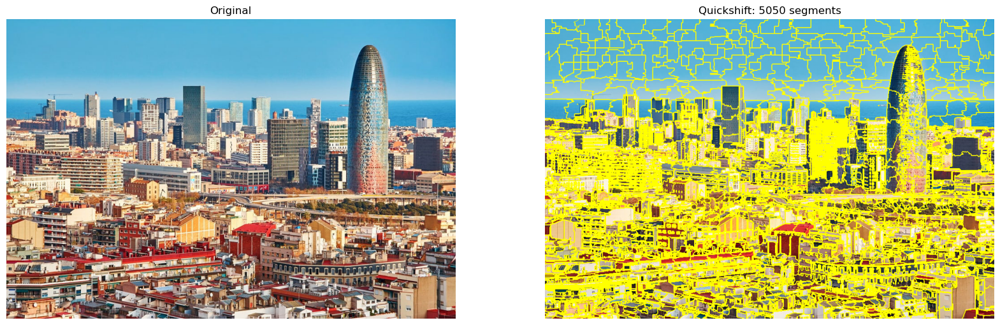

Experiment with kernel_size variations:


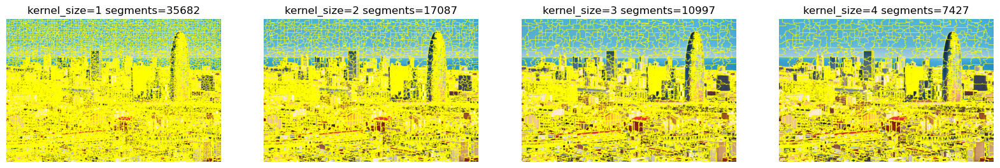

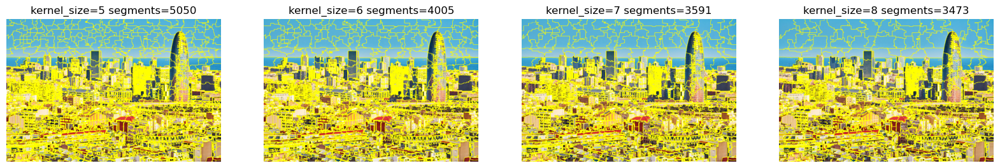

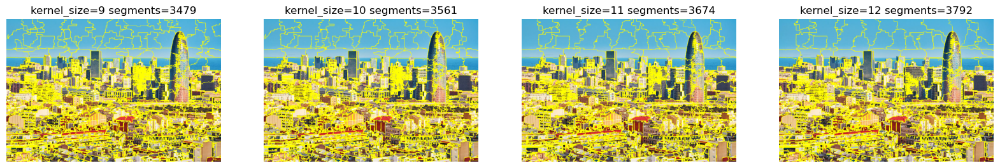

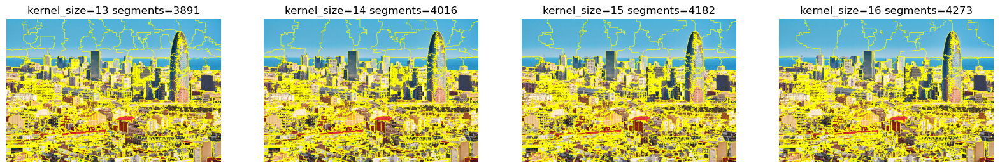

In [73]:
from skimage.segmentation import quickshift

# Read image and segment it using Quickshift
segments_quick = quickshift(bcn)
bcn_quick = mark_boundaries(bcn, segments_quick)

fig=plt.figure(figsize=(20,15))

# First image: Original
fig.add_subplot(1,2,1)
plt.title("Original")
plt.imshow(bcn) 
plt.axis("off")

# Second image: Quickshift
fig.add_subplot(1,2,2)
plt.title(f"Quickshift: {len(np.unique(segments_quick))} segments")
plt.imshow(bcn_quick) 
plt.axis("off")

plt.show()

# Experiment: kernel_size=1,2,...,16
print("Experiment with kernel_size variations:")
for i in range(3):
    fig = plt.figure(figsize=(20,16))
    for j in range(1,5):
        kernel_size = 4*i+j
        segments = quickshift(bcn, kernel_size=kernel_size)
        fig.add_subplot(1,4,j)
        plt.title(f"kernel_size={kernel_size} segments={len(np.unique(segments))}")
        plt.imshow(mark_boundaries(bcn, segments))
        plt.axis('off')
    plt.show()

h) Comment what the algorithm is (in up to 3 lines).
**We find the cluster centers using the quickshift mode-seeking algorithm (moving to the most densely distributed area). This increases efficiency (compared to K-means, which is a blind movement) and builds trees connected to adjacent elements. It is achieved by setting a superpixel (root) and considering pixels with distance value (by some metric in the (x,y,R,G,B) space). The pixels than its window converges to a defines pixel mode (most seen pixel value near him), will be in the same segment as this modal pixel.**

### Comparison of segmentation algorithms

Apply the best set of parameters of each algorithm and apply it to: 
1) Original image
1) Salt and pepper noise version of this image
2) Flipped image (horizontally)
3) Canny edge detector result of this image. 

Plot the image and its results of fezenswalb and SLIC algorithm in a 1x3 subplots. 

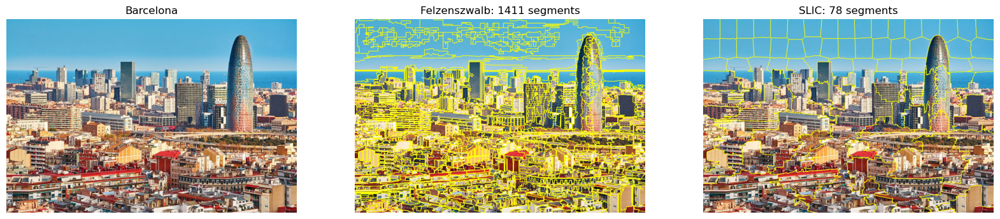

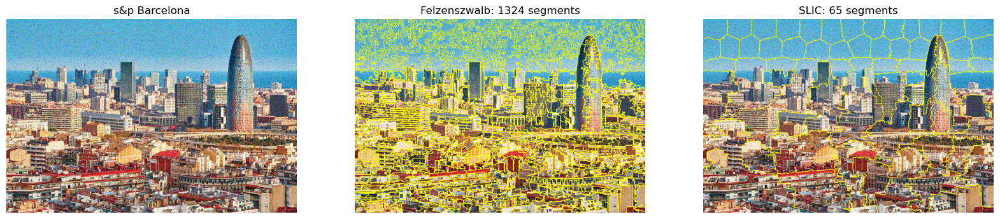

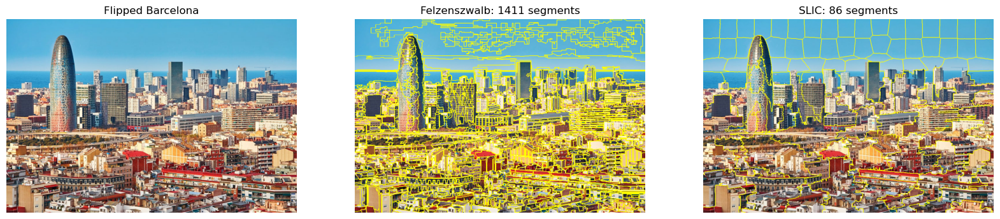

ValueError: channel_axis=-1 indicates multichannel, which is not supported for a two-dimensional image; use channel_axis=None if the image is grayscale

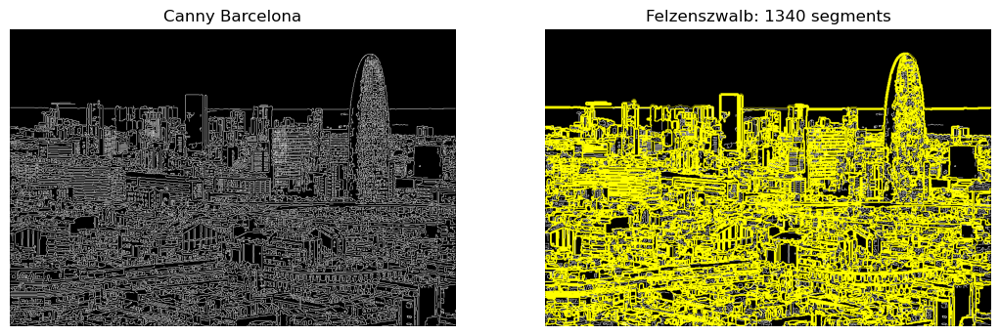

In [16]:
"""
Based on the previous experiments, the best set of parameters found is:
Felzenszwalb: scale=200, sigma=0.5,      min_size=100
SLIC:         n_seg=200, compactness=10, sigma=1
"""
"""
Based on the previous experiments, the best set of parameters found is:
Felzenszwalb: scale=200, sigma=0.5,      min_size=100
SLIC:         n_seg=200, compactness=10, sigma=0.5
"""
from skimage.color import rgb2gray    # Grayscale images for Canny
from skimage.feature import canny     # For Canny edge detector
from skimage.util import random_noise # To generate s&p noise

# Construct images asked
imgs = [bcn, random_noise(bcn,mode='s&p'), np.fliplr(bcn), canny(rgb2gray(bcn))]
titles = ['Barcelona', 's&p Barcelona', 'Flipped Barcelona', 'Canny Barcelona']

# Show them in 1x3 subplots applying Felzenszwalb & SLIC
for im,t in zip(imgs,titles):
    fig=plt.figure(figsize=(20,15))
    
    # First image: Original
    fig.add_subplot(1,3,1)
    plt.title(t)
    plt.imshow(im, cmap='gray') 
    plt.axis("off")

    # Second image: Felzenszwalb
    segments_fz = felzenszwalb(im, scale=200, sigma=0.5, min_size=100)
    fig.add_subplot(1,3,2)
    plt.title(f"Felzenszwalb: {len(np.unique(segments_fz))} segments")
    plt.imshow(mark_boundaries(im, segments_fz), cmap='gray') 
    plt.axis("off")
    
    # Third image: SLIC
    segments_slic = slic(im, n_segments=200, compactness=10, sigma=0.5, start_label=1)
    fig.add_subplot(1,3,3)
    plt.title(f"SLIC: {len(np.unique(segments_slic))} segments")
    plt.imshow(mark_boundaries(im, segments_slic), cmap='gray') 
    plt.axis("off")

    plt.show()

- Do the transformations affect the segmentation? Why or why not? **Generally, they affect. Felzenszwalb: it is very sensitive to the salt & pepper noise (the change of color affects it because it takes similar neighbours as a cluster) and in the Canny image segmentation the sky and sea is better segmentated (it only separates based on edges). However, there are no changes in the segments made for the flipped image (the local behaviour is the same). SLIC: it is less sensitive to the salt & pepper noise (based on a density approach) and the flipped image is segmented differently than the original one. The worst case, however, is the Canny segmentation, since the pixels have no R,G,B values.**
- Can the number of segments can be used as a criterion for the performance of the algorithms? **No, note that for the s&p Felzenszwalb image we have 1300 segments but the sky segmentation of the original image is better.**

## 3.2 Segmentation via clustering

In this exercise, you will implement hierarchical clustering to segment the "images_notebook/loro.png" image in gray scales. First load and visualize the image, then implement hierarchical clustering over the pixels and plot the final results side by side to the original image

Hint: Sklearn has a hierarchical clustering implementation you should use. Reshape your dataset such that you have a 2 dimensional array. Use linkage "ward" and grid_to_graph function for the connectivity parameter. 

<img src="images_notebook/loro_segmentation.jpg" width=600>

In [79]:
from sklearn.cluster import AgglomerativeClustering 
??AgglomerativeClustering


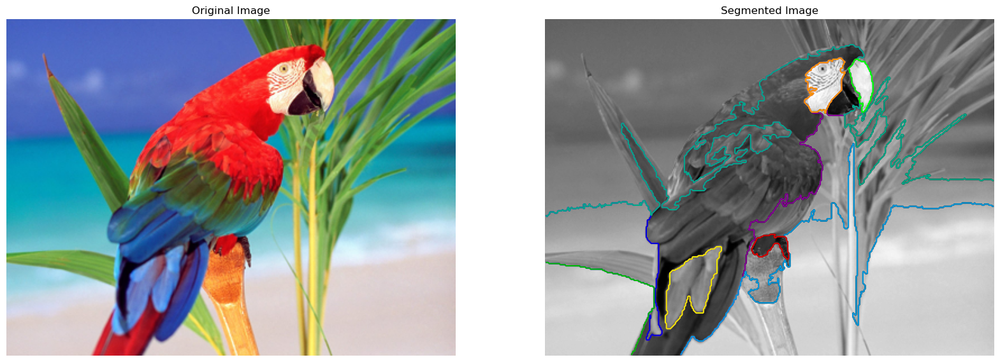

In [13]:
from sklearn.feature_extraction.image import grid_to_graph      # For connectivity
from sklearn.cluster import AgglomerativeClustering  # For hierarchical clustering
from skimage.color import rgb2gray                     # To get image in grayscale

# Load image and construct the grayscale one
loro = io.imread("images_notebook/loro.png")
loro_gray = rgb2gray(loro)

fig=plt.figure(figsize=(20,15))

# First image: Original loro
fig.add_subplot(1,2,1)
plt.title("Original Image")
plt.imshow(loro) 
plt.axis("off")

# Hierarchical clustering with n regions
n = 10
ward = AgglomerativeClustering(n_clusters=n, linkage="ward", connectivity=grid_to_graph(*loro_gray.shape))
#The result of this reshaping operation is a 2D column vector where each row corresponds to a pixel intensity from the original grayscale image.To be represented as a single column. 
#In the context of hierarchical clustering, it makes the data suitable for input to algorithms that expect a 2D array with samples along one axis and features along the other.
#X serà una única dimensió amb 300*400 elements, loro_gray tenia shape (400,300)
# The -1 in the reshape function is a placeholder that means "whatever is needed." It allows NumPy to automatically calculate the size of that dimension based on the size of the original array. In this case, it's used for the number of rows.
X = np.reshape(loro_gray, (-1, 1))
#ward.fit(X) is called, the hierarchical clustering algorithm is applied to the reshaped grayscale image data (X). 
#The algorithm computes clusters based on the specified parameters (number of clusters, linkage criterion, and connectivity), and it assigns labels to each pixel in the image based on the resulting clusters. 
#These labels will later be used to visualize or analyze the segmented regions in the image.
ward.fit(X)
#The next is used to reshape the labels obtained from the clustering back to the shape of the original grayscale image (loro_gray).
#ward.labels_: This attribute of the AgglomerativeClustering object contains the cluster labels assigned to each data point (in this case, each pixel) during the clustering process.
#It assigns in each pixel position one of the previous clusters labels found (values from 0 to 9, as n=10)
labels = np.reshape(ward.labels_, loro_gray.shape)

# Second image: Segmented loro
fig.add_subplot(1,2,2)
plt.title("Segmented Image")
plt.imshow(loro_gray, cmap='gray')
for l in range(n):
    #labels == l: This creates a binary mask where the elements equal to the cluster label l are set to True, and the rest are set to False. 
    #This binary mask essentially highlights the pixels that belong to the cluster with label l.
    plt.contour(labels == l, colors=[plt.cm.nipy_spectral(l/n)])
plt.axis("off")

plt.show()

## Video segmentation

Given the video stored in ‘Barcelona-sequence’, which contains images acquired by a static camera, we ask you to:
- Find the temporal segments of the video (shots). Where the scene change? (Section 3.1)
- Extract the background images and thus, remove all the "artifacts" considered as foreground related to movement. (Section 3.2)




<img src="images_notebook/screenshot.png" width=600>

## 3.3 Segmentation of video shots

Read and visualize the sequence of images "images_notebook/Barcelona-sequence".

**Hint:** In order to read a collection of images, we wil use the function [animation.FuncAnimation](https://matplotlib.org/2.0.0/api/_as_gen/matplotlib.animation.FuncAnimation.html). Observe in the following Example, how FuncAnimation is used to read and visualize a sequence of frames. Explore the parameters of animation.FuncAnimation().

<IPython.core.display.Javascript object>


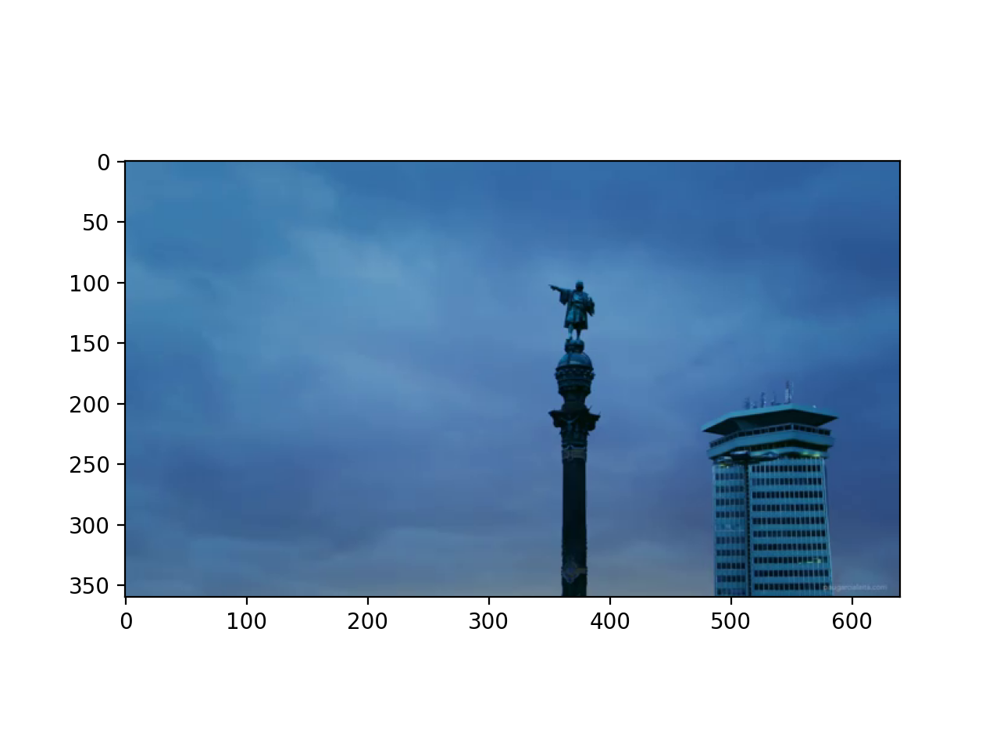

In [20]:
import matplotlib.animation as animation
from skimage import img_as_float
from skimage.exposure import histogram
#Changing the pluggin is necessary always when visualizing a video!
%matplotlib nbagg 

ic = io.ImageCollection('images_notebook/Barcelona-sequence/*.png')
        # Reading a sequence of images from a folder


%matplotlib nbagg 
    #Changing the pluggin is necessary always when visualizing a video!

fig = plt.figure()  # Create figure
im = plt.imshow(ic[0], animated=True) #Visualize the first image

def updatefig1(i):   #Updating the frame visualization
    im.set_array(ic[i]) #Changing the content of the canvas
    return im, #to return a tuple!

plt.show()
ani = animation.FuncAnimation(fig, updatefig1, interval=5, frames=290, blit=True, repeat=False)
plt.show()

a) Find where a shot (scene) finishes and the following starts (the shot boundaries). To achieve this goal, we are going to compute the difference between the histograms of consecutive frames. The proposed solution required:

- Compute the histogram for each RGB channel

- The 'total' histogram of the image is computed as the sum of the three histograms

- Compute the mean of the difference (in absolute value) between the histograms of two consecutive frames

Those differences with largest values corresponds to the transitions between shots. 

Therefore, **we need to create a funtion which return an array with the differences between histograms. We will plot the resulting array in order to localice the maximum values as well as a suitable threshold to define localize the transitions.**

<img src="images_notebook/histogramshot.png" width=600>
<img src="images_notebook/difference_histograms.png">

To solve this exercise, you need to create a **temporal plot** showing a frame by frame difference measure to be defined by you, being applicable to distinguish the shots. Define a criterion to detect the boundaries of the shots and visualize it in a static plot. **it refeers to make a plot with the changes in the frames, it's what is done in the next cell"

The plot above was obtain by using 64 bins histogram and the measure as mean of absolute difference. 

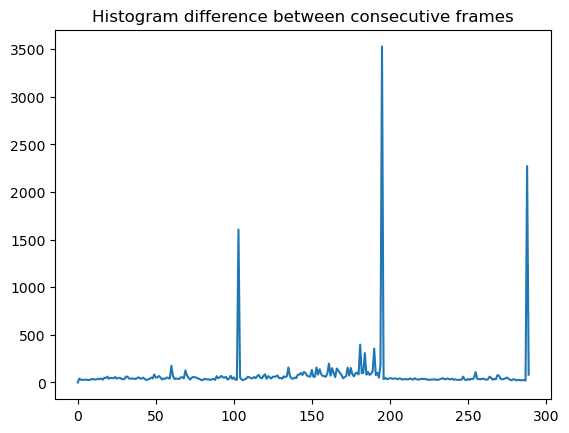

In [23]:
"""
The previous histograms made 64 bins with the range provided
by the image (commonly not the [0,1] interval entirely). We will work with the whole range for each 
histogram (that would be with exactly 256 bins in uint8 images and 
with the whole [0,1] interval in float images) in order to avoid getting some supposed confusing changes of scenes.
"""

#We return to inline engine
%matplotlib inline

from skimage import img_as_float        # Image to [0,1] range for histograms
from skimage.exposure import histogram  # For the histograms

"""
Get histogram differences for an image 
collection composed of RGB images
"""
def histograms_differences(collection):
    diffs = []
    #Compute the histogram of the current image
    #histogram function returns hist: the values of the histogram, and bin_centers: the values at the center of the bins
    [hist_r, bins_r]=histogram((img_as_float(collection[0])[:,:,0]),source_range='dtype')
    [hist_g, bins_g]=histogram((img_as_float(collection[0])[:,:,1]),source_range='dtype')
    [hist_b, bins_b]=histogram((img_as_float(collection[0])[:,:,2]),source_range='dtype')
    #Sum all RGB histograms
    hist_im = np.array(hist_r+hist_g+hist_b)
    
    # Fill the array of differences
    for im in collection:
        [hist_r, bins_r]=histogram((img_as_float(im)[:,:,0]),source_range='dtype')
        [hist_g, bins_g]=histogram((img_as_float(im)[:,:,1]),source_range='dtype')
        [hist_b, bins_b]=histogram((img_as_float(im)[:,:,2]),source_range='dtype')
        #Sum all RGB histograms
        hist_next_im = np.array(hist_r+hist_g+hist_b)
        
        
        # Difference between histograms
        diffs.append(np.mean(np.absolute(hist_next_im - hist_im)))
        
        # Update y for next iteration
        hist_im = hist_next_im
        
    return np.array(diffs)

mean_differences = histograms_differences(ic)
#define x and y axis values
plt.plot(np.arange(len(ic)), mean_differences)
plt.title("Histogram difference between consecutive frames")
plt.show()

b) Additionally, create an interactive plot executing the following code in "Example A". Substitute the bottom plot with the temporal plot showing the differences between the consecutive frames. 

In [14]:
# Example A
#I have to define in the next cell a function called data_gen in order to see the interactive plot, taking every frame-step one more value of the mean_differences
def data_gen():
    return enumerate(mean_differences)


<IPython.core.display.Javascript object>


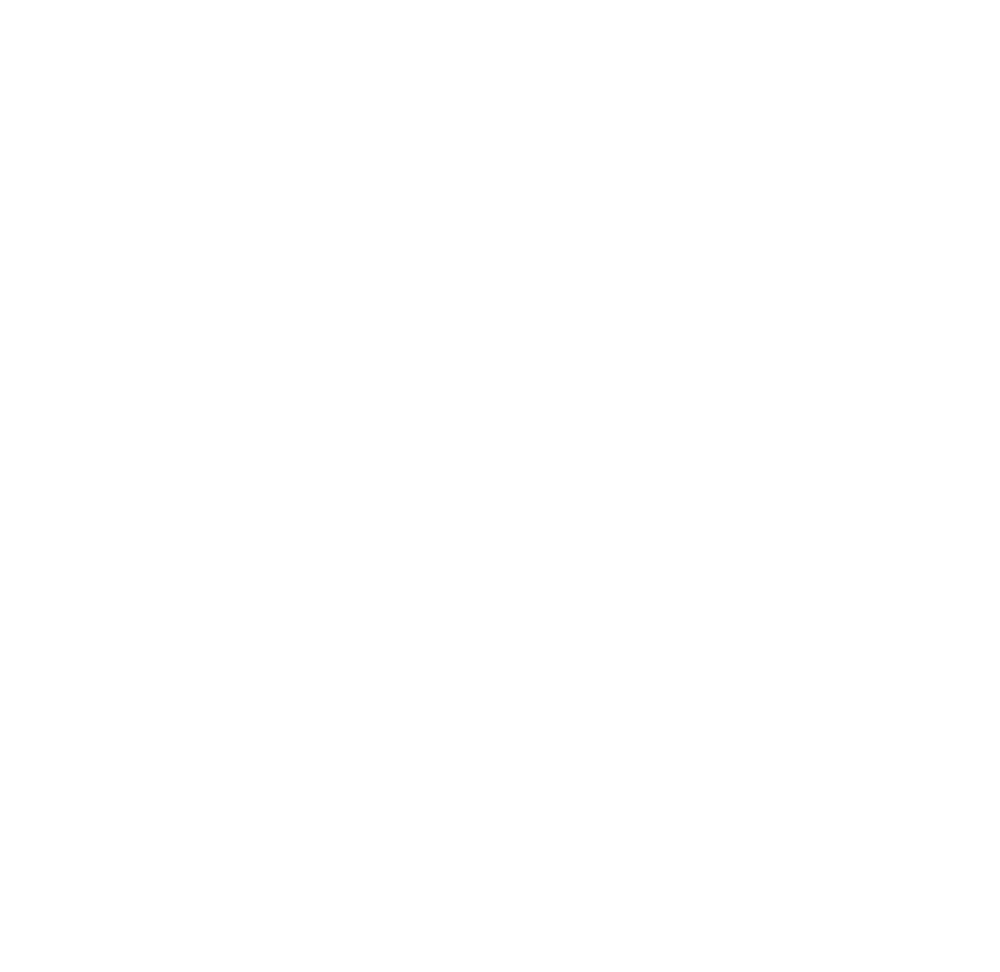

In [32]:
%matplotlib nbagg


# Make figure big enough for video and plot
#This line retrieves the default figure size from the plt.rcParamsDefault dictionary. w and h will be assigned the default width and height values, respectively.
w,h = plt.rcParamsDefault["figure.figsize"]
#This line modifies the default figure size. The new figure size has the same width (w) as the default, but the height (1.3 * h) is increased by 30%.
plt.rcParams['figure.figsize'] = [w,1.3*h]
#This line creates a figure (fig) and two subplots (ax1 and ax2). 
#The subplots are arranged in two rows (2) and one column (1). Therefore, ax1 and ax2 represent the two axes objects for the two subplots.
fig, (ax1, ax2) = plt.subplots(2,1)

# First subplot: video
im = ax1.imshow(ic[0], animated=True)
#Updatefig1 defined before
ani1 = animation.FuncAnimation(fig, updatefig1, interval=5, frames=len(ic), blit=True, repeat=False)

# Second sublot: dynamic graphic
xdata = [0]
ydata = [mean_differences[0]]
line, = ax2.plot(xdata,ydata)

#Data_gen will be like updatefig1, it will update the figure displayed in each iteration
def data_gen(i):
    xdata.append(i)
    ydata.append(mean_differences[i])
    line.set_data(xdata,ydata)
    return line,

#Maximum sizes of the plot
ax2.set_xlim(0, len(mean_differences)*1.1)
ax2.set_ylim(0, max(mean_differences)*1.1)
#FuncAnimation updates fig using data_gen
ani2 = animation.FuncAnimation(fig, data_gen, frames=np.arange(len(ic)), interval=5, blit=True, repeat=False)

plt.show()
plt.rcParams['figure.figsize'] = plt.rcParamsDefault["figure.figsize"]


c) Show the initial and final images of each shot extracted as follows:

<img src="images_notebook/result_shot_detection.png">


Use the previous plot to define the proper threshold value over the differences of histograms. Use the threshold to localize indexes of the array returned by the function proposed in the previous question and, therefore, localize the initial and final frames for each shot as shown in the reference image


In [34]:
print(np.concatenate([[0], np.where(mean_differences > 1000)[0], [len(ic)]]))

[  0 103 195 288 290]


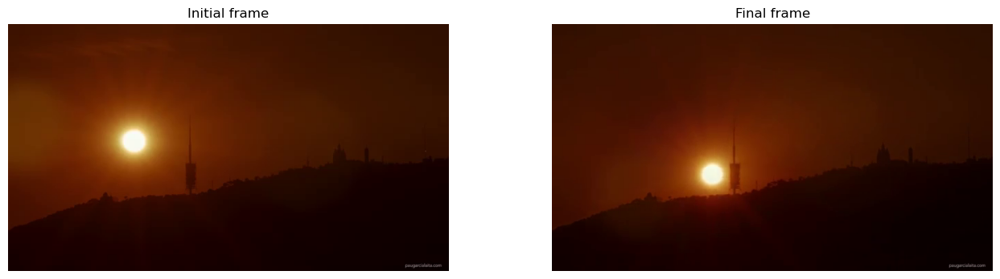

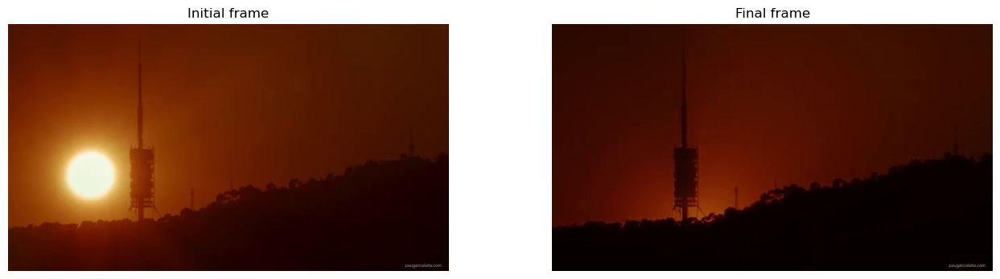

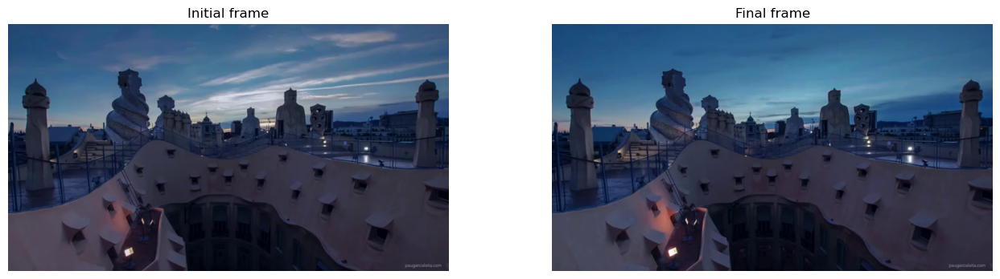

In [40]:
"""
To copy the example we delete the initial and final image
of the last scene (since we are only shown 3 scenes)
"""
%matplotlib inline

# Based on the mean_differences plot, we decide 1000 as the threshold
threshold = 1000

# Initial and final frames based on threshold (indexes makes a partition of scenes by index)
#np.where will return (array([103, 195, 288]),), so thats why we take [0]
#We put first a 0 in order to get the first image
indexes = np.concatenate([[0], np.where(mean_differences > threshold)[0]])


# Plot them, we don't take into consideration the final frame as it is not a scene
#Like this, we plot the first image, as we concatenate with 0, then the frume just before the next peak (ic[indexes[i+1]-1]) for each change
for i in range(len(indexes)-1):
    fig=plt.figure(figsize=(16,4))

    # First image: Initial frame
    fig.add_subplot(1,2,1)
    plt.title("Initial frame")
    plt.imshow(ic[indexes[i]])
    plt.axis("off")
    
    # Second image: Final frame
    fig.add_subplot(1,2,2)
    plt.title("Final frame")
    plt.imshow(ic[indexes[i+1]-1]) 
    plt.axis("off")
    plt.show()

d) Which measure have you used in order to visually distinguish the shots in a plot? Explain your solution.

**Answer:** The suggested measure (the mean of the difference, in absolute value, between the histograms of two consecutive frames) since it allows us to combine the information of each color channel and compare it to the following image. However, as we have mentioned in a), applying this strategy with the 64-bin histogram showed in the example would have given us one more change in scene. To avoid this we have considered, for each frame, the 256 possible values each channel can take.

e) Would your video segmentation strategy be able to separate and track objects? Argue your answer.

**Answer:** No, we can only detect abrupt color changes in the scene. We can not apply it for object detection as objects maybe do not move. Traking is even more impossible, as we don't know the position of the changing values of the pixels in each frame, only the absolute mean sum of differences.

f) Would your video segmentation strategy be able to capture continuous transition? Argue your answer.

**Answer:** No, continuous transition means no abrupt changes between frames (leading to small differences in their histograms), so we would be unable to detect these changes.

## 3.4 Background subtraction

Apply the background subtraction algorithm (check theory material).

<img src="images_notebook/screenshot2.png" width=500>

a) Visualize the following images for each different scene of the video:

    1) an image belonging to the shot
    2) the background image, and
    3) the foreground.
    
**Hint**: You can construct a mask obtained from the original image and the background in order to know which parts of the image form part from the foreground and recover from the original image just the foreground regions.

0.15


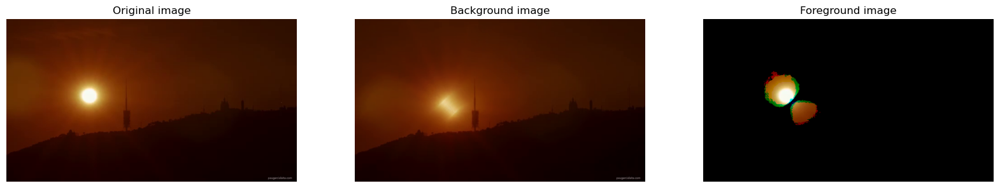

0.15


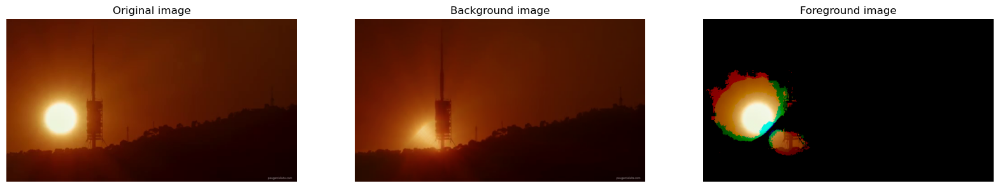

0.15


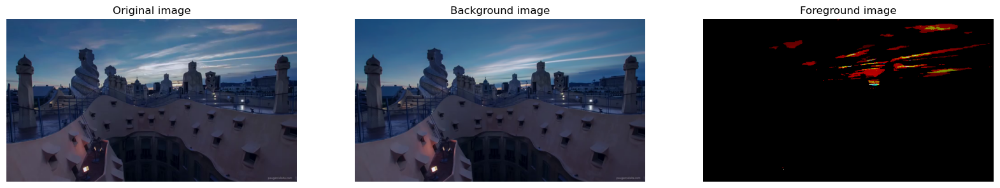

In [64]:
"""
NOTE: Working with the video of 3.3 stored in the variable ic, whose images are uint8
"""
%matplotlib inline

# We keep the foreground for f)
foregrounds = []

# Show the initial frame of each scene as asked
#Indexes calculated before
for i in range(len(indexes)-1):
    frame = ic[indexes[i]]
    
    # Scene background image extraction with median filter
    background = np.median(ic[indexes[i]:indexes[i+1]], axis=0).astype('uint8')
    
    
    # Foreground image, we substract because we want a RGB foreground
    foreground_diff = abs(img_as_float(frame) - img_as_float(background))
    #threshold = np.mean(foreground_mask)
    threshold = 0.15
    mask = foreground_diff > threshold
    foreground = np.copy(img_as_float(frame))
    foreground[~mask] = 0
    foregrounds.append(foreground)

    fig=plt.figure(figsize=(20,15))
    
    # First image: Original image
    fig.add_subplot(1,3,1)
    plt.title("Original image")
    plt.imshow(frame) 
    plt.axis("off")

    # Second image: Background image
    fig.add_subplot(1,3,2)
    plt.title("Background image")
    plt.imshow(background) 
    plt.axis("off")

    # Third image: Foreground image
    fig.add_subplot(1,3,3)
    plt.title("Foreground image")
    plt.axis("off")
    plt.imshow(foreground)

    plt.show()

b) What do the static background images represent? 

**Answer:** The static background images are an approximation of the background for each frame of the scene (since we have used the median filter to get it).

c) What happens if the shots are not correctly extracted? And, what happens if you find too many shots in the video? 

**Answer:** If the shots are not correctly extracted the median filter will be incorrectly applied and the background will not be obtained cleanly. This will lead to a poor foreground image. Moreover, if we find too many shots, we will have less frames per scene and the median filter will be less accurate, giving (generally) worse results. 

d) What happens if you subtract the background image from the original one?

**Answer:** We get an image with the pixels that are far from the median painted, nevertheless, this is not the foreground, it is only a reference mask to know wich pixels correspond to foreground

e) In which situations does the algorithm work and in which it does not? Do you see any additional application for this algorithm?

**Answer:** As we have already mentioned, when there are too many shots the background image obtained for each one can be a bad representation. The algorithm is thought for scenes with static background, it would not work if the background was dynamic. Also bad if a moving object stays in a place the majority of the time. Finally, a possible example would be movement detection: a camera could be recording a room and a dynamic person would be recognised since they would not be part of the background image.

f) Visualize the highest and lowest similarity frame with respect to the foreground images of each scene. You can use the metric of your like, explain why you picked it. 

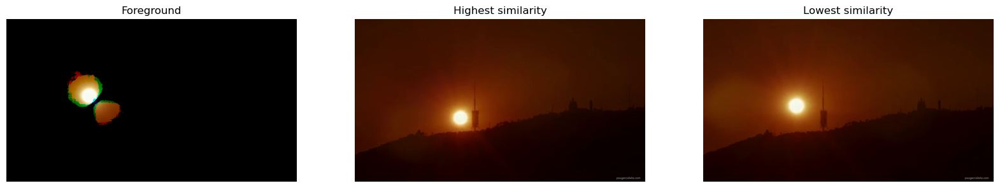

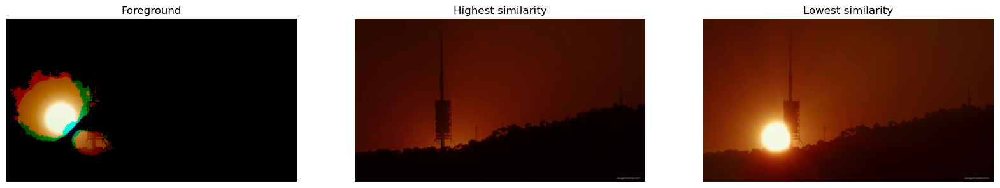

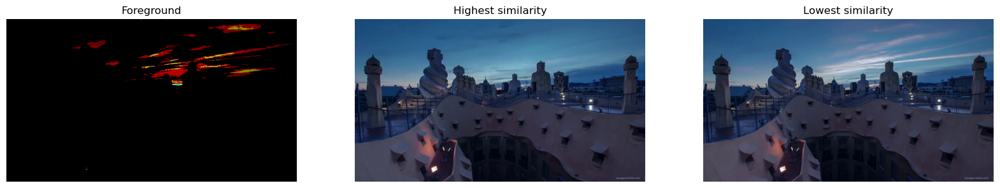

In [65]:
"""
NOTE: The foregrounds are float images and the frames uint8 so we need conversion. The metric used 
      is the sum of the difference (in absolute value) of RGB values per pixel. We think it can measure 
      the change of each color for pixels and can be added without cancellation (we take absolute value).
"""

# Get highest and lowest similarity frame of scene to img
def get_highest_lowest(img, scene):
    diffs = np.array([np.sum(np.abs(img - img_as_float(frame))) for frame in scene])
    return scene[np.argmin(diffs)], scene[np.argmax(diffs)]

for i,f in enumerate(foregrounds):
    # Highest and lowest similarity images
    h,l = get_highest_lowest(f,ic[indexes[i]:indexes[i+1]])
    
    fig=plt.figure(figsize=(20,15))
    
    # First image: Foreground image
    fig.add_subplot(1,3,1)
    plt.title("Foreground")
    plt.imshow(f) 
    plt.axis("off")

    # Second image: Highest similarity image
    fig.add_subplot(1,3,2)
    plt.title("Highest similarity")
    plt.imshow(h) 
    plt.axis("off")

    # Third image: Lowest similarity image
    fig.add_subplot(1,3,3)
    plt.title("Lowest similarity")
    plt.imshow(l)
    plt.axis("off")

    plt.show()